In [2]:
import cv2
import torch
import numpy as np
import random

from pathlib import Path
from skimage.filters import threshold_otsu
from matplotlib import pyplot as plt

from detect.utils import read_yolo_labels, BBox
from detect.components import PositionStructure

def show_img(img):
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.show()

In [43]:
import os
os.environ['http_proxy'] = "http://127.0.0.1:7890" 
os.environ['https_proxy'] = "https://127.0.0.1:7890" 
os.environ['socks_proxy'] = "https://127.0.0.1:7891" 

model_type = 'DPT_Large'
# model_type = 'DPT_Hybrid'
# model_type = 'MiDaS_small'

device = torch.device('cuda:1')
midas = torch.hub.load("intel-isl/MiDaS", model_type)
midas.to(device)
midas.eval()


midas_transforms = torch.hub.load("intel-isl/MiDaS", "transforms")

if model_type == "DPT_Large" or model_type == "DPT_Hybrid":
    transform = midas_transforms.dpt_transform
else:
    transform = midas_transforms.small_transform

Using cache found in /home/lucien/.cache/torch/hub/intel-isl_MiDaS_master
Using cache found in /home/lucien/.cache/torch/hub/intel-isl_MiDaS_master


In [9]:
img_names = [
    '20220628_1_000000056',
    '20220628_1_0000012870',
    '20220628_1_000004541',
    '20220628_1_000004540',
    '20220628_1_000004583',
    '20220628_1_0000012865',
    '20220628_1_000001799',
    '20220628_1_000004550',
    'NB_000328',
    '002434',
    'NB_000189',
    '20220628_1_0000012862',
    '20220628_1_0000012863',
    '20220628_1_000004125',
    'NB_000301',
    '20220628_1_000005207',
    '20220628_1_0000013179',
    '20220628_1_000001128',
    '20220628_1_000005038',
    '20220628_1_000004124',
    '20220628_1_000003852',
    '20220628_1_000004456',
    '20220628_1_000004085',
    '20220628_1_000001001',
    '20220628_1_000000550',
    '20220628_1_000000728',
    '20220628_1_000004877',
    'RightOutsideCamera_20211212_0246_0th_424',
    '20220628_1_000003854',
    'NB_000329',
    '001014',
    '20220628_1_000006905',
    '20220628_1_000000073',
    '20220628_1_0000013119',
    'NB_000126',
    '20220628_1_000005019',
    'NB_000177',
    '20220628_1_000004885',
    '20220628_1_000000064',
    'NB_000324',
    '20220628_1_000005591',
    '001590',
    '000671',
    '20220628_1_000004883',
    '20220628_1_000004471',
    '20220628_1_000004277',
    'NB_000316',
    '20220628_1_000004538',
    '20220628_1_000003860',
    '20220628_1_0000012879',
    '20220628_1_000005078',
    '20220628_1_000001183',
    '001496',
    '20220628_1_000005125',
    '20220628_1_000004429',
    '20220628_1_000000016',
    '20220628_1_0000012868',
    '001069',
    'NB_000268',
    '20220628_1_000005134',
    '20220628_1_0000012880',
    '20220628_1_000001147'
]

In [49]:
def detect_by_depth(img, bolt_bbox):
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    input_batch = transform(img).to(device)

    with torch.no_grad():
        prediction = midas(input_batch)

        prediction = torch.nn.functional.interpolate(
            prediction.unsqueeze(1),
            size=img.shape[:2],
            mode="bicubic",
            align_corners=False,
        ).squeeze()

    cv2.rectangle(img, (int(bolt_bbox.xmin), int(bolt_bbox.ymin)), (int(bolt_bbox.xmax), int(bolt_bbox.ymax)), 
                  (255, 0, 0), 1)
    show_img(img)
    
    output = prediction.cpu().numpy()
    plt.imshow(output)
    plt.show()
    
    depth_boundary = np.max(output[int(bolt_bbox.ymin):int(bolt_bbox.ymax), int(bolt_bbox.xmin):int(bolt_bbox.xmax)])
    output[output <= depth_boundary] = 0
    plt.imshow(output)
    plt.show()
    output = ((output - np.min(output)) / (np.max(output) - np.min(output)) * 255).astype(np.uint8)
    # output  = (output / np.max(output) * 255).astype(np.uint8)
    # show_img(output)
    # plt.imshow(output)
    # plt.show()
    return output

In [341]:
def detect_by_cv2(img):
    # gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray = img
    blurred = cv.bilateralFilter(img, 9, 75, 75)
    _, thresh = cv2.threshold(blurred, np.mean(blurred), 255, cv2.THRESH_BINARY_INV)

    edges = cv2.dilate(cv2.Canny(thresh, 100, 250), None)
    show_img(edges)

    # cnt = sorted(cv2.findContours(edges, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)[-2], key=cv2.contourArea)[-1]
    # mask = np.zeros((256,256), np.uint8)
    # masked = cv2.drawContours(mask, [cnt], -1, 255, -1)
    
    lines = cv2.HoughLines(edges, 1, np.pi/180, 240, 10)
    if lines is None:
        print('no detection')
        return
    
    for line in lines:
        rho, theta = line[0]
        a = np.cos(theta)
        b = np.sin(theta)
        x0 = a * rho
        y0 = b * rho
        # x1 stores the rounded off value of (r* cosΘ - 1000 * sinΘ)
        x1 = int(x0 + 1000 * (-b))
        # y1 stores the rounded off value of (r * sinΘ + 1000 * cosΘ)
        y1 = int(y0 + 1000 * (a))
        # x2 stores the rounded off value of (r * cosΘ + 1000 * sinΘ)
        x2 = int(x0 - 1000 * (-b))
        # y2 stores the rounded off value of (r * sinΘ - 1000 * cosΘ)
        y2 = int(y0 - 1000 * (a))

        cv2.line(gray, (x1, y1), (x2, y2), (0, 0, 255), 2)

#     thresh = threshold_otsu(gray)
#     img_otsu = gray > thresh

#     def filter_image(image, mask):

#         r = image[:,:,0] * mask
#         g = image[:,:,1] * mask
#         b = image[:,:,2] * mask

#         return np.dstack([r,g,b])
    
    # filtered = filter_image(img, img_otsu)
    # filtered = img * mask

    # low = np.array([0, 0, 0])
    # high = np.array([215, 70, 70])

    # mask = cv2.inRange(gray, 0, gray.mean() - 10)

    show_img(gray)
    # show_img(masked)

In [391]:
def detect_by_canny(img):
    show_img(img)
    # gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray = img
    # blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    # show_img(blurred)
    blurred = gray
    # _, thresh = cv2.threshold(blurred, np.mean(blurred), 255, cv2.THRESH_BINARY)
    # show_img(thresh)
    edges = cv2.Canny(blurred, 50, 150)
    show_img(edges)
    # print(np.sum(edges))
    
    # kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    # # apply the dilation operation to the edged image
    # dilate = cv2.dilate(edges, kernel, iterations=1)
    # contours, hierarchy = cv2.findContours(dilate, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    # print(contours)
    # cv2.drawContours(img, contours, -1, (0, 255, 0), -1)
    # show_img(img)
    
    # minLineLength = 30
    # maxLineGap = 3        
    # lines = cv2.HoughLinesP(edges, 1, np.pi/180, 50, minLineLength=100, maxLineGap=5)
#     lines = cv2.HoughLines(edges, 1, np.pi/180, 100)
    
#     if lines is None:
#         print('no detection')
#         return
        
#     for line in lines:
#         # x1, y1, x2, y2 = line[0]
#         rho, theta = line[0]
#         a = np.cos(theta)
#         b = np.sin(theta)
#         x0 = a * rho
#         y0 = b * rho
#         # x1 stores the rounded off value of (r* cosΘ - 1000 * sinΘ)
#         x1 = int(x0 + 1000 * (-b))
#         # y1 stores the rounded off value of (r * sinΘ + 1000 * cosΘ)
#         y1 = int(y0 + 1000 * (a))
#         # x2 stores the rounded off value of (r * cosΘ + 1000 * sinΘ)
#         x2 = int(x0 - 1000 * (-b))
#         # y2 stores the rounded off value of (r * sinΘ - 1000 * cosΘ)
#         y2 = int(y0 - 1000 * (a))

#         cv2.line(gray, (x1, y1), (x2, y2), (255, 0, 0), 2)
        
#     show_img(gray)

In [245]:
def detect_by_seg(img):
    show_img(img)
    img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB);
    
    segmentator = cv2.ximgproc.segmentation.createGraphSegmentation(sigma=0.5, k=500, min_size=1000)
    segment = segmentator.processImage(img)
    seg_image = np.zeros(img.shape, np.uint8)

    for i in range(np.max(segment)):
      # 將第 i 個分割的座標取出
      y, x = np.where(segment == i)

      # 隨機產生顏色
      color = [random.randint(0, 255), random.randint(0, 255),random.randint(0, 255)]

      # 設定第 i 個分割區的顏色
      for xi, yi in zip(x, y):
        seg_image[yi, xi] = color

    # 將原始圖片與分割區顏色合併
    result = cv2.addWeighted(img, 0.3, seg_image, 0.7, 0)

    # 顯示結果
    show_img(result)

In [7]:
label_dir = Path('/home/lucien/repos/yolov5/runs/detect/rail_without_rail_anomaly/')
img_dir = Path('/home/lucien/datasets/koujian_data/images_preprocessed/')

preds = read_yolo_labels(label_dir,
                         '/home/lucien/repos/yolov5/data/rail_without_rail_ab.yaml',
                        conf_threshold=0.7)

[I 230331 10:25:29 utils:167] read yolo results
17009it [00:05, 3054.39it/s]


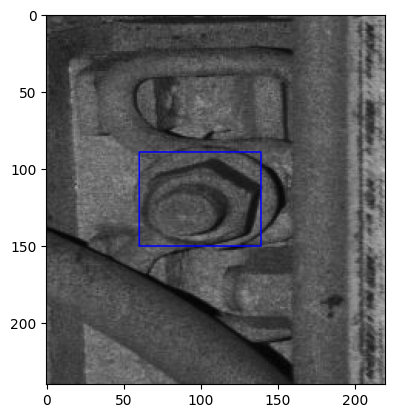

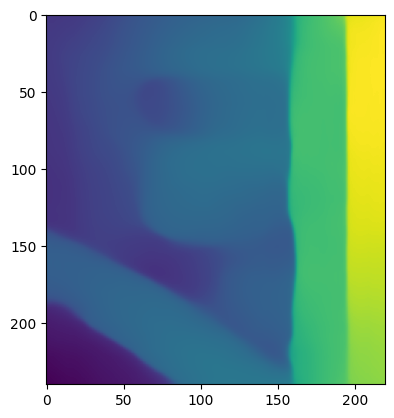

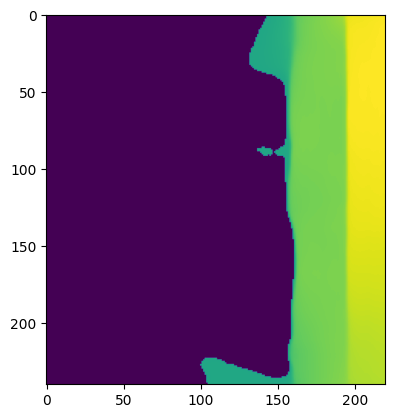

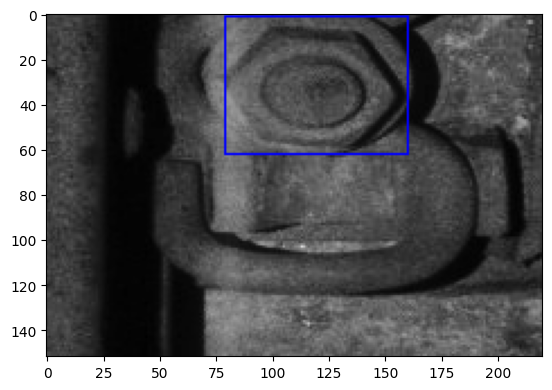

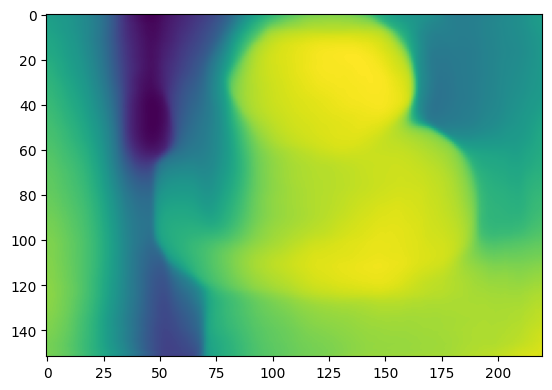

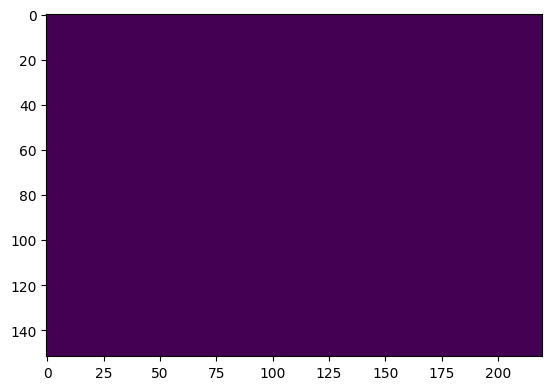

/tmp/ipykernel_19758/3564797897.py:27: RuntimeWarning: invalid value encountered in divide
  output = ((output - np.min(output)) / (np.max(output) - np.min(output)) * 255).astype(np.uint8)


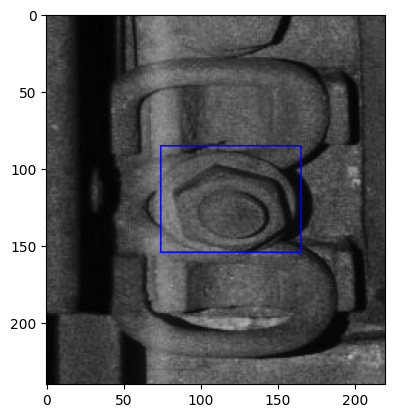

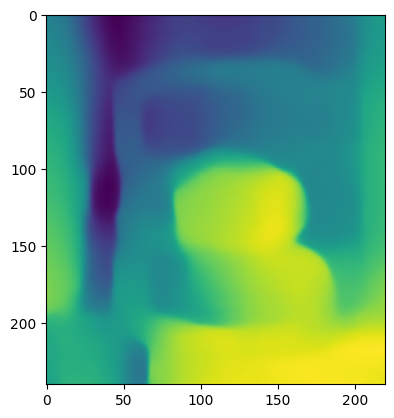

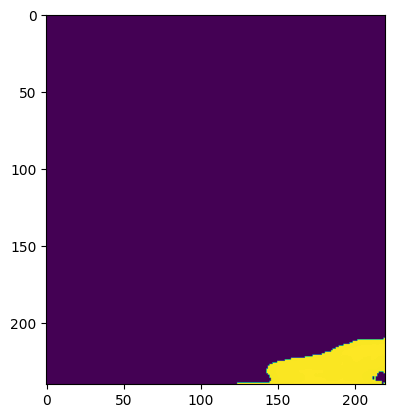

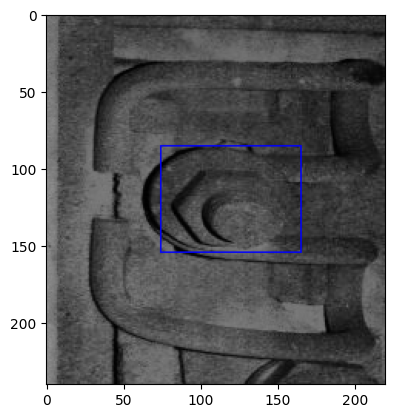

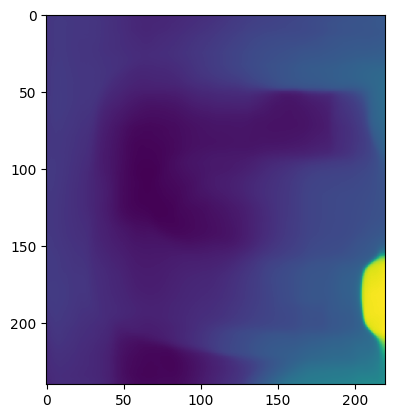

...

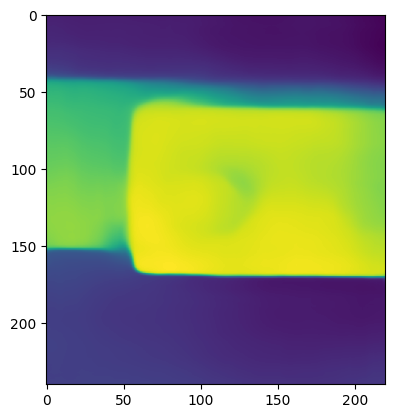

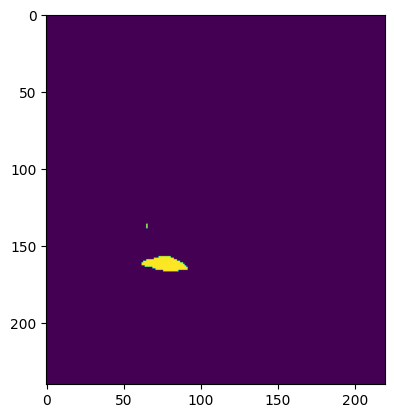

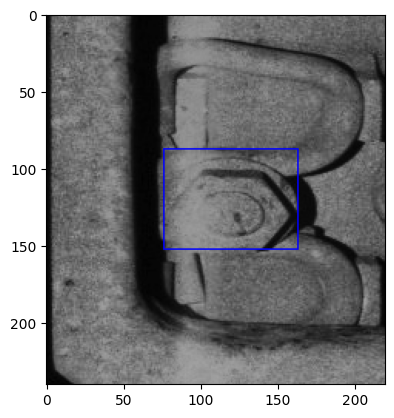

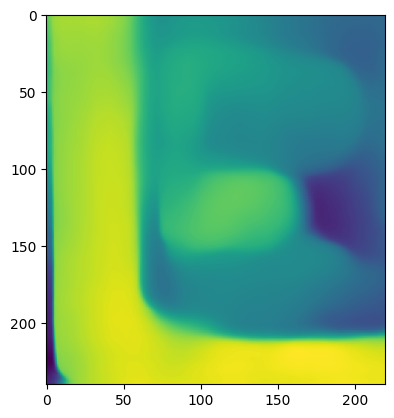

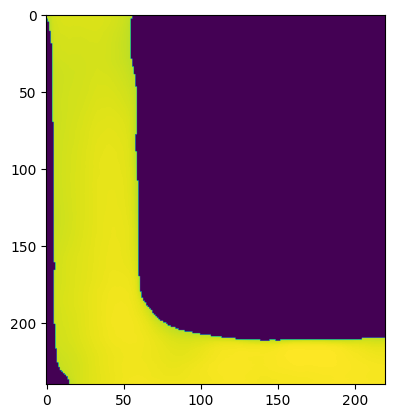

In [50]:
def crop_img(img, bbox, right):
    h, w = img.shape[:2]
    xmin = 0
    xmax = 0
    ymin = 0
    ymax = 0
    top = 120
    bottom = 120
    l = 100
    r = 120
    if right:
        xmin = r - bbox.width * w / 2
        xmax = r + bbox.width * w / 2
        if bbox.center[1] * h > top:
            ymin = top - bbox.height * h / 2
            ymax = bottom + bbox.height * h / 2
        else:
            ymin = bbox.center[1] * h - bbox.height * h / 2
            ymax = bbox.center[1] * h + bbox.height * h / 2
        return img[max(int(bbox.center[1] * h - top), 0):int(bbox.center[1] * h + bottom), 
                   max(int(bbox.center[0] * w - r), 0):int(bbox.center[0] * w + l), :], BBox(xmin, ymin, xmax, ymax)
    else:
        xmin = l - bbox.width * w / 2
        xmax = l + bbox.width * w / 2
        if bbox.center[1] * h > top:
            ymin = top - bbox.height * h / 2
            ymax = bottom + bbox.height * h / 2
        else:
            ymin = bbox.center[1] * h - bbox.height * h / 2
            ymax = bbox.center[1] * h + bbox.height * h / 2
        return img[max(int(bbox.center[1] * h - top), 0):int(bbox.center[1] * h + bottom), 
                   max(int(bbox.center[0] * w - l), 0):int(bbox.center[0] * w + r), :], BBox(xmin, ymin, xmax, ymax)


img_names = list(set(img_names))
for name in img_names:
    img_path = img_dir / f'{name}.jpg'
    if not img_path.exists():
        img_path = img_dir / f'{name}.png'

    img = cv2.imread(str(img_dir / f'{name}.jpg'))
    if img is None:
        continue
        
    pred = preds.get(name)
    if not pred:
        continue
    ps = PositionStructure(pred)
    if ps.get_components_by_cat('turnout'):
        continue
    rails = ps.get_components_by_cat('rail')
    if not rails or len(rails) != 1:
        continue
    rail_bbox = rails[0].bbox
    rail_center = rail_bbox.center
    
    spikes = ps.get_components_by_cat('spike_8B')
    if not spikes:
        continue
    for spike in spikes:
        right = True
        spike_x, spike_y = spike.bbox.center
        height = spike.bbox.height
        if spike_x < rail_center[0]:
            right = False
        region = BBox(
            0 if right else rail_center[0],
            spike_y - height if right else spike_y - height - 30,
            rail_center[0] if right else 1,
            spike_y + height + 30 if right else spike_y + height
        )
        opposite_comps = ps.get_components_by_bbox(region)
        for comp in opposite_comps:
            if comp.cat == 'bolt_in':
                check = False
                if not comp.parent or comp.parent.cat != 'spike_8B':
                    check = True
                elif len(comp.parent.get_children('component')) != 2:
                    check = True
                    
                if True:
                    cropped, bolt_bbox = crop_img(img, comp.bbox, not right)
                    detect = detect_by_depth(cropped, bolt_bbox)
                    # cropped_w, cropped_h = detect.shape
                    # mean_val = np.mean(
                    #     detect[(cropped_w // 2 - 100):(cropped_w // 2 + 100),
                    #            (cropped_h // 2 - 100):(cropped_h // 2 + 100)]
                    # )
                    # detect_by_seg(detect)
                    # detect_by_canny(detect)
                    # detect_by_canny(cropped)
                    # detect_by_cv2(cropped)